# Importing Libraries

In [1]:
import os
import numpy as np
import pandas as pd

import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt
%matplotlib inline

from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist

import warnings
warnings.filterwarnings("ignore")

# Reading Data

In [2]:
data = pd.read_csv("Dataset/data.csv")
genreData = pd.read_csv("Dataset/data_by_genres.csv")
yearData = pd.read_csv("Dataset/data_by_year.csv")

In [3]:
print(data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170653 entries, 0 to 170652
Data columns (total 19 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   valence           170653 non-null  float64
 1   year              170653 non-null  int64  
 2   acousticness      170653 non-null  float64
 3   artists           170653 non-null  object 
 4   danceability      170653 non-null  float64
 5   duration_ms       170653 non-null  int64  
 6   energy            170653 non-null  float64
 7   explicit          170653 non-null  int64  
 8   id                170653 non-null  object 
 9   instrumentalness  170653 non-null  float64
 10  key               170653 non-null  int64  
 11  liveness          170653 non-null  float64
 12  loudness          170653 non-null  float64
 13  mode              170653 non-null  int64  
 14  name              170653 non-null  object 
 15  popularity        170653 non-null  int64  
 16  release_date      17

In [4]:
data.head(5)

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo
0,0.0594,1921,0.982,"['Sergei Rachmaninoff', 'James Levine', 'Berli...",0.279,831667,0.211,0,4BJqT0PrAfrxzMOxytFOIz,0.878000,10,0.665,-20.096,1,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",4,1921,0.0366,80.954
1,0.9630,1921,0.732,['Dennis Day'],0.819,180533,0.341,0,7xPhfUan2yNtyFG0cUWkt8,0.000000,7,0.160,-12.441,1,Clancy Lowered the Boom,5,1921,0.4150,60.936
2,0.0394,1921,0.961,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,0.328,500062,0.166,0,1o6I8BglA6ylDMrIELygv1,0.913000,3,0.101,-14.850,1,Gati Bali,5,1921,0.0339,110.339
3,0.1650,1921,0.967,['Frank Parker'],0.275,210000,0.309,0,3ftBPsC5vPBKxYSee08FDH,0.000028,5,0.381,-9.316,1,Danny Boy,3,1921,0.0354,100.109
4,0.2530,1921,0.957,['Phil Regan'],0.418,166693,0.193,0,4d6HGyGT8e121BsdKmw9v6,0.000002,3,0.229,-10.096,1,When Irish Eyes Are Smiling,2,1921,0.0380,101.665


In [5]:
print(genreData.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2973 entries, 0 to 2972
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              2973 non-null   int64  
 1   genres            2973 non-null   object 
 2   acousticness      2973 non-null   float64
 3   danceability      2973 non-null   float64
 4   duration_ms       2973 non-null   float64
 5   energy            2973 non-null   float64
 6   instrumentalness  2973 non-null   float64
 7   liveness          2973 non-null   float64
 8   loudness          2973 non-null   float64
 9   speechiness       2973 non-null   float64
 10  tempo             2973 non-null   float64
 11  valence           2973 non-null   float64
 12  popularity        2973 non-null   float64
 13  key               2973 non-null   int64  
dtypes: float64(11), int64(2), object(1)
memory usage: 325.3+ KB
None


In [6]:
genreData.head(5)

,mode,genres,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
0,1,21st century classical,0.979333,0.162883,1.602977e+05,0.071317,0.606834,0.361600,-31.514333,0.040567,75.336500,0.103783,27.833333,6
1,1,432hz,0.494780,0.299333,1.048887e+06,0.450678,0.477762,0.131000,-16.854000,0.076817,120.285667,0.221750,52.500000,5
2,1,8-bit,0.762000,0.712000,1.151770e+05,0.818000,0.876000,0.126000,-9.180000,0.047000,133.444000,0.975000,48.000000,7
3,1,[],0.651417,0.529093,2.328809e+05,0.419146,0.205309,0.218696,-12.288965,0.107872,112.857352,0.513604,20.859882,7
4,1,a cappella,0.676557,0.538961,1.906285e+05,0.316434,0.003003,0.172254,-12.479387,0.082851,112.110362,0.448249,45.820071,7


In [7]:
print(yearData.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              100 non-null    int64  
 1   year              100 non-null    int64  
 2   acousticness      100 non-null    float64
 3   danceability      100 non-null    float64
 4   duration_ms       100 non-null    float64
 5   energy            100 non-null    float64
 6   instrumentalness  100 non-null    float64
 7   liveness          100 non-null    float64
 8   loudness          100 non-null    float64
 9   speechiness       100 non-null    float64
 10  tempo             100 non-null    float64
 11  valence           100 non-null    float64
 12  popularity        100 non-null    float64
 13  key               100 non-null    int64  
dtypes: float64(11), int64(3)
memory usage: 11.1 KB
None


In [8]:
yearData.head(5)

,mode,year,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
0,1,1921,0.886896,0.418597,260537.166667,0.231815,0.344878,0.205710,-17.048667,0.073662,101.531493,0.379327,0.653333,2
1,1,1922,0.938592,0.482042,165469.746479,0.237815,0.434195,0.240720,-19.275282,0.116655,100.884521,0.535549,0.140845,10
2,1,1923,0.957247,0.577341,177942.362162,0.262406,0.371733,0.227462,-14.129211,0.093949,114.010730,0.625492,5.389189,0
3,1,1924,0.940200,0.549894,191046.707627,0.344347,0.581701,0.235219,-14.231343,0.092089,120.689572,0.663725,0.661017,10
4,1,1925,0.962607,0.573863,184986.924460,0.278594,0.418297,0.237668,-14.146414,0.111918,115.521921,0.621929,2.604317,5


# Data Visualization and EDA

In [9]:
soundFeatures = ['acousticness', 'danceability', 'energy', 'instrumentalness', 'liveness', 'valence']
fig = px.line(yearData, x='year', y=soundFeatures)
fig.show()

In [10]:
topGenres = genreData.nlargest(10, 'popularity')
fig = px.bar(topGenres, x='genres', y=['acousticness', 'danceability', 'energy', 'instrumentalness', 'liveness', 'valence'], barmode='group')
fig.show()

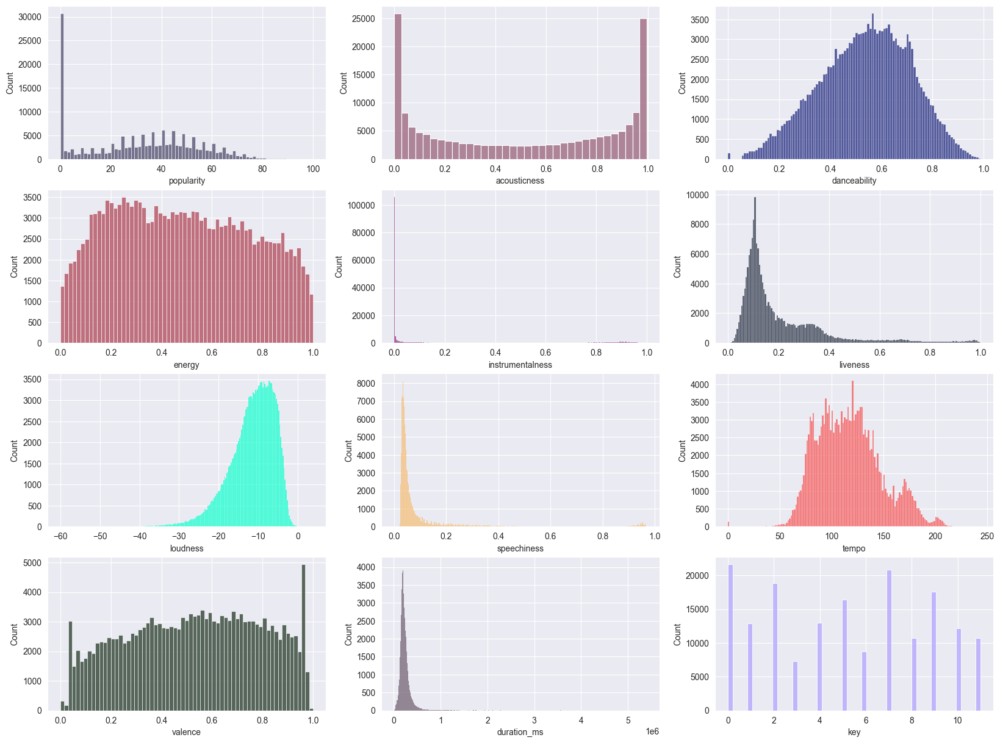

In [11]:
fig, axs = plt.subplots(nrows=4, ncols=3, figsize=(20,15))
sns.histplot(ax=axs[0][0], x=data['popularity'], color="#4C4C6D")
sns.histplot(ax=axs[0][1], x=data['acousticness'], color="#99627A")
sns.histplot(ax=axs[0][2], x=data['danceability'], color="#1D267D")
sns.histplot(ax=axs[1][0], x=data['energy'], color="#B04759")
sns.histplot(ax=axs[1][1], x=data['instrumentalness'], color="#8B1874")
sns.histplot(ax=axs[1][2], x=data['liveness'], color="#212A3E")
sns.histplot(ax=axs[2][0], x=data['loudness'], color="#00FFCA")
sns.histplot(ax=axs[2][1], x=data['speechiness'], color="#F6BA6F")
sns.histplot(ax=axs[2][2], x=data['tempo'], color="#F45050")
sns.histplot(ax=axs[3][0], x=data['valence'], color="#263A29")
sns.histplot(ax=axs[3][1], x=data['duration_ms'], color="#6D5D6E")
sns.histplot(ax=axs[3][2], x=data['key'], color="#B2A4FF")
plt.show()

# Clustering Genres with K-Means

In [12]:
genreClusterPipeline = Pipeline([('scaler', StandardScaler()), ('kmeans', KMeans(n_clusters=10))])
X = genreData.select_dtypes(np.number)
genreClusterPipeline.fit(X)
genreData['cluster'] = genreClusterPipeline.predict(X)

### Visualizing the clusters with t-SNE

In [13]:
tsnePipeline = Pipeline([('scaler', StandardScaler()), ('tsne', TSNE(n_components=2, verbose=1))])
genreEmbedding = tsnePipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x','y'], data=genreEmbedding)
projection['genres'] = genreData['genres']
projection['cluster'] = genreData['cluster']
fig = px.scatter(projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'genres'])
fig.show()

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2973 samples in 0.006s...
[t-SNE] Computed neighbors for 2973 samples in 0.191s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2973
[t-SNE] Computed conditional probabilities for sample 2000 / 2973
[t-SNE] Computed conditional probabilities for sample 2973 / 2973
[t-SNE] Mean sigma: 0.777516
[t-SNE] KL divergence after 250 iterations with early exaggeration: 76.106247
[t-SNE] KL divergence after 1000 iterations: 1.392825


# Clustering Songs with K-Means

In [14]:
songClusterPipeline = Pipeline([('scaler', StandardScaler()), ('kmeans', KMeans(n_clusters=20, verbose=False))], verbose=False)
X = data.select_dtypes(np.number)
numberCols = list(X.columns)
songClusterPipeline.fit(X)
songClusterLabels = songClusterPipeline.predict(X)
data['clusterLabel'] = songClusterLabels
print(data['clusterLabel'].head(10))

0     4
1    10
2     4
3    12
4    12
5    10
6    12
7     0
8    14
9    10
Name: clusterLabel, dtype: int32


In [15]:
# X = data.select_dtypes(np.number)
# scaler = StandardScaler()
# scaledData = scaler.fit_transform(X)
# print(scaledData)

In [16]:
pcaPipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
songEmbedding = pcaPipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=songEmbedding)
projection['title'] = data['name']
projection['cluster'] = data['clusterLabel']
fig = px.scatter(projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'])
fig.show()

In [17]:
# !pip install spotipy
# import spotipy
# from spotipy.oauth2 import SpotifyClientCredentials
# from collections import defaultdict
#
# sp = spotipy.Spotify(auth_manager=SpotifyClientCredentials(client_id=os.environ["SPOTIFY_CLIENT_ID"],
#                                                            client_secret=os.environ["SPOTIFY_CLIENT_SECRET"]))
#
#
# def find_song(name, year):
#     song_data = defaultdict()
#     results = sp.search(q='track: {} year: {}'.format(name, year), limit=1)
#     if results['tracks']['items'] == []:
#         return None
#
#     results = results['tracks']['items'][0]
#     track_id = results['id']
#     audio_features = sp.audio_features(track_id)[0]
#
#     song_data['name'] = [name]
#     song_data['year'] = [year]
#     song_data['explicit'] = [int(results['explicit'])]
#     song_data['duration_ms'] = [results['duration_ms']]
#     song_data['popularity'] = [results['popularity']]
#
#     for key, value in audio_features.items():
#         song_data[key] = value
#
#     return pd.DataFrame(song_data)


from collections import defaultdict
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist
import difflib

number_cols = ['valence', 'year', 'acousticness', 'danceability', 'duration_ms', 'energy', 'explicit',
               'instrumentalness', 'key', 'liveness', 'loudness', 'mode', 'popularity', 'speechiness', 'tempo']


def get_song_data(song, spotify_data):
    try:
        song_data = spotify_data[(spotify_data['name'] == song['name'])
                                 & (spotify_data['year'] == song['year'])].iloc[0]
        return song_data

    except IndexError:
        # return find_song(song['name'], song['year'])
        print("NotFound")


def get_mean_vector(song_list, spotify_data):
    song_vectors = []

    for song in song_list:
        song_data = get_song_data(song, spotify_data)
        if song_data is None:
            print('Warning: {} does not exist in Spotify or in database'.format(song['name']))
            continue
        song_vector = song_data[number_cols].values
        song_vectors.append(song_vector)

    song_matrix = np.array(list(song_vectors))
    return np.mean(song_matrix, axis=0)


def flatten_dict_list(dict_list):
    flattened_dict = defaultdict()
    for key in dict_list[0].keys():
        flattened_dict[key] = []

    for dictionary in dict_list:
        for key, value in dictionary.items():
            flattened_dict[key].append(value)

    return flattened_dict


def recommend_songs(song_list, spotify_data, n_songs=10):
    metadata_cols = ['name', 'year', 'artists']
    song_dict = flatten_dict_list(song_list)

    song_center = get_mean_vector(song_list, spotify_data)

    scaler = songClusterPipeline.steps[0][1]
    scaled_data = scaler.transform(spotify_data[number_cols])
    scaled_song_center = scaler.transform(song_center.reshape(1, -1))
    distances = cdist(scaled_song_center, scaled_data, 'cosine')
    index = list(np.argsort(distances)[:, :n_songs][0])

    rec_songs = spotify_data.iloc[index]
    rec_songs = rec_songs[~rec_songs['name'].isin(song_dict['name'])]
    return rec_songs[metadata_cols].to_dict(orient='records')


recommend_songs([{'name': 'Come As You Are', 'year': 1991}], data)

[{'name': 'In the End', 'year': 2000, 'artists': "['Linkin Park']"},
 {'name': 'Shimmer', 'year': 1997, 'artists': "['Fuel']"},
 {'name': 'Symphony Of Destruction', 'year': 1992, 'artists': "['Megadeth']"},
 {'name': 'Breaking the Habit', 'year': 2003, 'artists': "['Linkin Park']"},
 {'name': 'Lovers Rock', 'year': 2014, 'artists': "['TV Girl']"},
 {'name': 'Fell On Black Days', 'year': 1994, 'artists': "['Soundgarden']"},
 {'name': 'New Divide', 'year': 2009, 'artists': "['Linkin Park']"},
 {'name': 'War of Change',
  'year': 2012,
  'artists': "['Thousand Foot Krutch']"},
 {'name': 'Freak', 'year': 1997, 'artists': "['Silverchair']"}]

In [18]:
# from flask import Flask, request, render_template
#
# app = Flask(__name__)
#
# @app.route('/')
# def render():
#     return render_template("index.html")
#
# @app.route('/predict', methods=['POST','GET'])
# def predict():
#     features = [x for x in request.form.values()]
#     object = {'name': features[0], 'year':features[1]}
#     final = [np.array(object)]
#     prediction = recommend_songs(final, data)
#
#     return render_template('index.html', pred='{}'.format(prediction))
#
# if __name__ == '__main__':
#     app.run(debug=True)